In [2]:
import os
import cv2
from PIL import Image
from src.apps.detection import Detection

In [3]:
root_path = os.path.expanduser('/Users/alimustofa/Downloads/')
detection_config = {
    'filename'          : 'avori_detection.pt',
    'image_size'        : 640,
    'classes'           : ['avocado'],
    'filter_classes'    : ['avocado'],
    'url'               : 'https://github.com/Alimustoofaa/ContainerNumber-Dev/releases/download/detection_v1/container_iso_maxgross.pt',
    'file_size'         : 14749585,
    
}

detection = Detection(root_path=root_path, model_config=detection_config)

Load model char detection


Using cache found in /Users/alimustofa/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2022-11-29 Python-3.9.6 torch-1.12.1 CPU

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients
Adding AutoShape... 


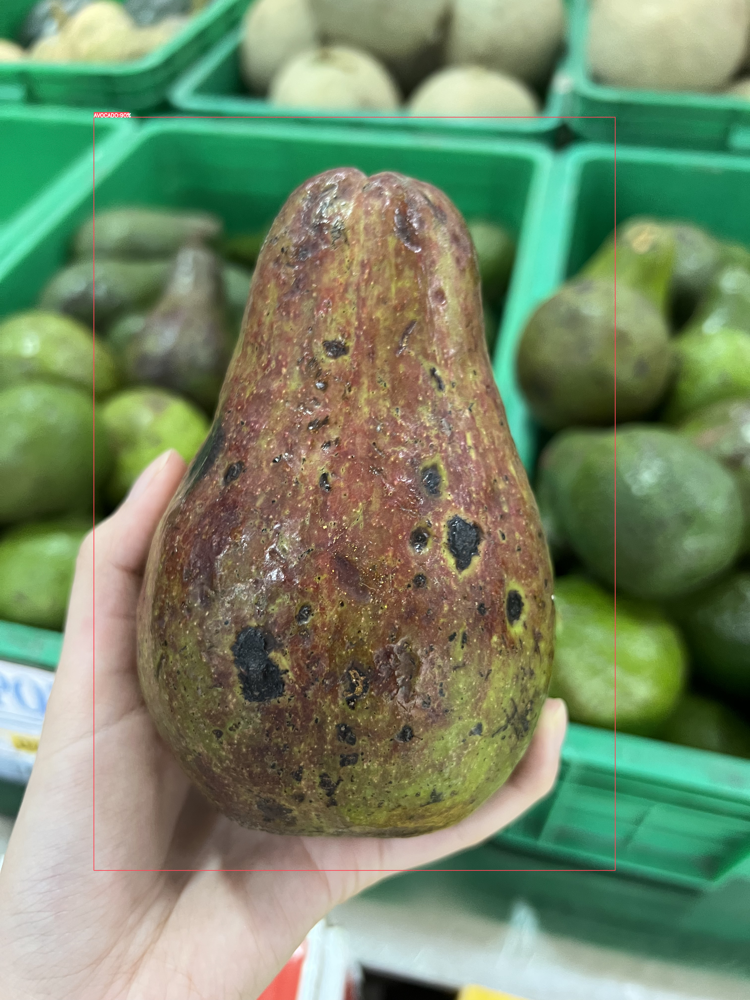

In [60]:
image = cv2.imread('./images/IMG_2161.jpg')
image_resize = cv2.resize(
                image.copy(),
                (detection_config['image_size'], 
                detection_config['image_size']), 
                interpolation = cv2.INTER_AREA)
results = detection(image_resize, size=detection_config['image_size'])
result_detection = detection.extract_results(
                results, 0.5,
                get_one=True, 
                boxes_ori=True, 
                resized_size=detection_config['image_size'], 
                image_shape=image.shape)
img_drawed = detection.visualize_result(image.copy(), result_detection)
Image.fromarray(cv2.cvtColor(img_drawed, cv2.COLOR_BGR2RGB))

In [54]:
import numpy as np

def get_avg_color(image):
    img_temp = image.copy()
    img_temp[:,:,0], img_temp[:,:,1], img_temp[:,:,2] = np.average(image, axis=(0,1))
    img_temp = cv2.resize(img_temp, (25,25))
    return img_temp

def get_texture_image(image):
    h, w = image.shape[:2]
    # Calculate centroid
    cx, cy= int(w/2), int(h/2)
    # radius crop
    radius_cx , radius_cy = int(0.7*cx), int(0.7*cy)
    x_min, y_min, x_max, y_max = cx-radius_cx, cy-radius_cy, cx+radius_cx, cy+radius_cy
    return image[y_min:y_max, x_min:x_max]

[378, 472, 2480, 3509]
[Detection] Got Container Number Detection : 0.9


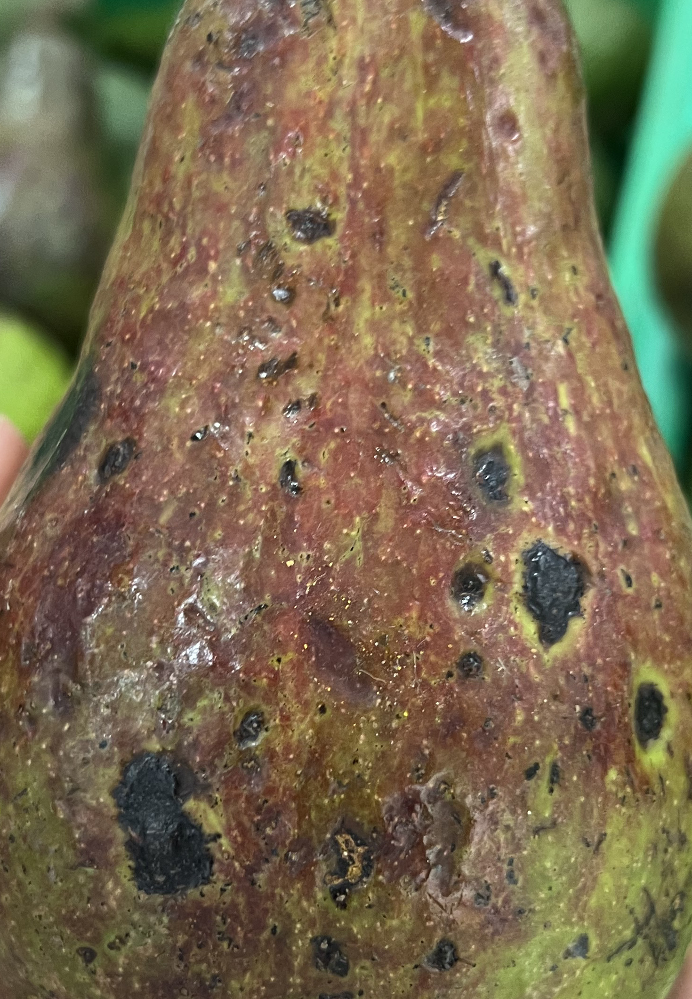

In [61]:
# Container number
try:
    confidence_c = result_detection['avocado'][0]['confidence']
    print(result_detection['avocado'][0]['bbox'])
    x_min_a, y_min_a, x_max_a, y_max_a = result_detection['avocado'][0]['bbox']
    img_avocade = image[y_min_a:y_max_a, x_min_a:x_max_a]
    # get texture image 
    img_texture = get_texture_image(img_avocade)
    print(f'[Detection] Got Container Number Detection : {confidence_c}')

    
    # print(f'[RESULT] Result Container Number : {container_number},{conf_container_number}')
except KeyError:
    print('[Detection] Container Number Not Found')
    container_number, conf_container_number = str(), float()
Image.fromarray(cv2.cvtColor(img_texture, cv2.COLOR_BGR2RGB))

In [62]:
# Get avg color
img_avg_color = get_avg_color(img_texture)
Image.fromarray(cv2.cvtColor(img_avg_color, cv2.COLOR_BGR2RGB))

In [63]:
# COLOR Data

import pandas as pd

index=["color", "color_name", "hex", "R", "G", "B"]
csv = pd.read_csv('colors.csv', names=index, header=None)
def recognize_color(R,G,B):
    minimum = 10000
    for i in range(len(csv)):
        d = abs(R- int(csv.loc[i,"R"])) + abs(G- int(csv.loc[i,"G"]))+ abs(B- int(csv.loc[i,"B"]))
        if(d<=minimum):
            minimum = d
            cname = csv.loc[i,"color_name"]
    return cname

b,g,r = img_avg_color[1,1]
b,g,r =int(b),int(g),int(r) 
recognize_color(b,g,r)

"Payne'S Grey"

In [64]:
import torch
import numpy as np
from torch import cuda, device
from torchvision import transforms
from src.utils.utils import download_and_unzip_model

class Classification:
    def __init__(self, root_path, model_config):
        self.root_path = root_path
        self.model_config = model_config
        self.model_name = f'{root_path}/{model_config["filename"]}'
        self.image_size = model_config['image_size']
        self.classes = model_config['classes']
        self.filter_classes = model_config['filter_classes']
        self.device = device("cuda:0" if cuda.is_available() else "cpu")
        self.transform_image = self.transfrom_img()
        self.model = self.__load_model()
    
    @staticmethod
    def __check_model(root_path:str, model_config:dict) -> None:
        if not os.path.isfile(f'{root_path}/{model_config["filename"]}'):
            download_and_unzip_model(
                root_dir    = root_path,
                name        = model_config['filename'],
                url         = model_config['url'],
                file_size   = model_config['file_size'],
                unzip       = False
            )
        else: print('Load model Classification')

    def __load_model(self):
        self.__check_model(self.root_path, self.model_config)
        print(self.model_name)
        return torch.load(self.model_name, map_location=self.device)
        
    def transfrom_img(self):
        return transforms.Compose([
            transforms.Resize(size=256),
            transforms.CenterCrop(size=224),
            transforms.ToTensor(),
            ])
    
    @classmethod
    def tensor_image_to_numpy(cls, tensor):
        return tensor.detach().cpu().numpy() if tensor.requires_grad else tensor.cpu().numpy()
    
    def image_processing(self, image):
        image = self.transform_image(image)
        image = image.unsqueeze(0)
        return image.to(self.device)
    
    def __call__(self, image):
        if type(image) == np.ndarray:
            image = Image.fromarray(image)
        image = image.resize((self.image_size, self.image_size))
        image = self.image_processing(image)
        if torch.cuda.is_available():
            image_tensor = image.view(1, 3, 224, 224).cuda()
        else:
            image_tensor = image.view(1, 3, 224, 224)
        
        with torch.no_grad():
            output = self.model(image_tensor)
        probs = torch.exp(output).to(self.device)
        topk, topclass = probs.topk(len(self.filter_classes), dim=1)
        result = list()
        for i in range(len(probs[0])):
            classes =  self.classes[topclass.cpu().numpy()[0][i]]
            conf = round(topk.cpu().numpy()[0][i], 2)
            if classes in self.filter_classes:
                result.append([classes, conf])
        return result

root_path = os.path.expanduser('/Users/alimustofa/Downloads/')
classification_config = {
    'filename'          : 'resnet34_model_400.pt',
    'image_size'        : 480,
    'classes'           :['almost_ripe', 'not_ripe', 'overripe', 'ripe'],
    'filter_classes'    : ['almost_ripe', 'not_ripe', 'overripe', 'ripe'],
    'url'               : 'https://github.com/Alimustoofaa/ContainerNumber-Dev/releases/download/detection_v1/container_iso_maxgross.pt',
    'file_size'         : 14749585,
}

# model_name = '/Users/alimustofa/Downloads/resnet34_model_avorit.pt'
avori_classification = Classification(root_path,model_config=classification_config)

Load model Classification
/Users/alimustofa/Downloads//resnet34_model_400.pt


Classification : not_ripe | confidecne : 89 %
Classification : ripe | confidecne : 5 %
Classification : almost_ripe | confidecne : 3 %
Classification : overripe | confidecne : 0 %


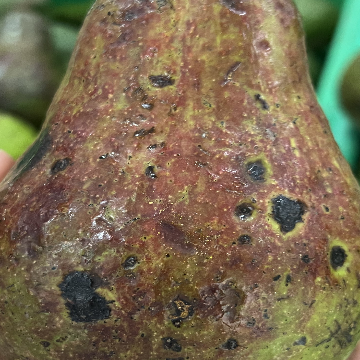

In [65]:
# images_crop = cv2.imread('./images/CLASSIFICATION/not_ripe/1bfb5e5d-eda7-43ff-962e-b5e26b1ce436.jpg')
img_texture = cv2.resize(img_texture, (360, 360))

results_class = avori_classification(img_texture)
for i in results_class:
    print(f'Classification : {i[0]} | confidecne : {int(i[1]* 100)} %')

img_texture = cv2.resize(img_texture, (360, 360))
Image.fromarray(cv2.cvtColor(img_texture, cv2.COLOR_BGR2RGB))

In [14]:
print(dict(zip(['almost_ripe', 'not_ripe', 'overripe', 'ripe'], map(float, [0.2,0.1,0.1,0.1]))))

{'almost_ripe': 0.2, 'not_ripe': 0.1, 'overripe': 0.1, 'ripe': 0.1}


In [10]:
import json
from json import JSONEncoder
class NumpyFloatValuesEncoder(json.JSONEncoder):
    def default(self, obj):
        if isinstance(obj, np.float32):
            return float(obj)
        return JSONEncoder.default(self, obj)


results_fruit = {'detection': {'label': 'avocado', 'conf': 0.92, 'bbox': [45, 143, 720, 1080]}, 'classification_texture': [['almost_ripe', 0.95], ['not_ripe', 0.04], ['overripe', 0.0], ['ripe', 0.0]], 'classification_color': 'Cool Grey'}
type(json.dumps(results_fruit, cls=NumpyFloatValuesEncoder))

str